In [1]:
from tensorflow import keras
import tensorflow as tf
from keras.layers import (Input, Dense, Conv2D, Conv2DTranspose, BatchNormalization, UpSampling2D, LeakyReLU,
                          Dropout, Flatten, Reshape, Lambda, MaxPool2D, RandomContrast, Concatenate, add, Cropping2D)
from keras.models import Model
from keras.optimizers import RMSprop, Adam
from math import log2
import matplotlib.pyplot as plt
from random import randint
import numpy as np

In [11]:
# Константы
img_side = 256

# Разбиваем датасет на тренировочную группу и группу валидации
def init_data_with_batch_size(batch_size):
    global train_data, val_data
    train_data = keras.preprocessing.image_dataset_from_directory(
        # Чтобы использовать "new_flowers" (расширенный датасет) надо запустить increasing_data.py
        "flowers",
        image_size=(img_side, img_side),
        shuffle=True,
        batch_size=batch_size,

        subset="training",
        validation_split=0.1,
        seed=42,
    )
    val_data = tf.keras.utils.image_dataset_from_directory(
        # Чтобы использовать "new_flowers" (расширенный датасет) надо запустить increasing_data.py
        "flowers",
        image_size=(img_side, img_side),
        shuffle=True,
        batch_size=batch_size,

        subset="validation",
        validation_split=0.1,
        seed=42,
    )

    # Убираем лейблы (т.к. у нас задача не распознавать изображения)
    train_data = train_data.map(lambda x, y: (x/255., x/255.))
    val_data = val_data.map(lambda x, y: (x/255., x/255.))

    return train_data, val_data

Модель

In [3]:
# Константы
dropout = 0.1
filters = 4   # Нижняя граница
amount_encode_layers = 6
amount_decode_layers = 6
max_boudle_residual_layers = 2  # Сколько слоёв с остаточноым обучением ПЕРЕД уменьшением/увеличением картинки

input_img = Input(shape=(img_side, img_side, 3))

"""Энкодер"""
# Это надо чтобы первый слой мог сложиться со следующим (при помощи add([x_temp, x]) )
x_temp = Conv2D(filters*2**amount_encode_layers, (3, 3), activation=LeakyReLU(0.1), padding="same")(input_img)

for i in range(amount_encode_layers, 0, -1):
    for _ in range(max_boudle_residual_layers):
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x_temp)
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
        x_temp = add([x_temp, x])

    x = MaxPool2D()(x_temp)
    x = Dropout(dropout)(x)
    x_temp = Conv2D(filters * 2**(i - 1), (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
encoder_output = x_temp

encoder = Model(input_img, encoder_output, name="encoder")
hidden_shape = [*encoder_output.shape[1:]]


"""Декодер"""
decoder_input = Input(hidden_shape)
x_temp = Conv2D(filters, (3, 3), activation=LeakyReLU(0.1), padding="same")(decoder_input)

# Расширяем карту признаков, увеличиваем картинку и количество фильтров
for i in range(amount_decode_layers):
    for _ in range(max_boudle_residual_layers):
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x_temp)
        x = Conv2D(filters * 2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)
        x_temp = add([x_temp, x])

    # Чтобы количество фильтров совпадало (для остаточного обучения)
    x_temp = Dropout(dropout)(x_temp)
    x_temp = Conv2DTranspose(filters * 2**(i + 1), (3, 3), activation=LeakyReLU(0.1), padding="same", strides=2)(x_temp)
x = x_temp

# Постепенно уменьшаем количество фильтров
for i in range(int(log2(x.shape[-1])), 1, -1):
    x = Dropout(dropout)(x)
    x = Conv2D(2**i, (3, 3), activation=LeakyReLU(0.1), padding="same")(x)

x = Conv2D(3, (3, 3), activation="sigmoid", padding="same")(x)

decoder = Model(decoder_input, x, name="decoder")

# Модель
vae = Model(input_img, decoder(encoder(input_img)), name="vae")
vae.compile(
    optimizer=Adam(1e-3),
    loss="binary_crossentropy",
    loss_weights=[1000],
)

vae.summary()

Model: "vae"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 encoder (Functional)        (None, 16, 16, 4)         320812    
                                                                 
 decoder (Functional)        (None, 256, 256, 3)       554879    
                                                                 
Total params: 875,691
Trainable params: 875,691
Non-trainable params: 0
_________________________________________________________________


In [5]:
train_data, val_data = init_data_with_batch_size(4)
vae.fit(
    train_data,
    epochs=100,
    validation_data=val_data,
)

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.
Epoch 1/100
630/630 [==============================] - 280s 442ms/step - loss: 553.9031 - val_loss: 518.7327
Epoch 2/100
630/630 [==============================] - 277s 439ms/step - loss: 521.2844 - val_loss: 510.8714
Epoch 3/100
630/630 [==============================] - 275s 436ms/step - loss: 511.2855 - val_loss: 492.8123
Epoch 4/100
630/630 [==============================] - 276s 437ms/step - loss: 498.0815 - val_loss: 491.3100
Epoch 5/100
630/630 [==============================] - 276s 438ms/step - loss: 492.7260 - val_loss: 484.2707
Epoch 6/100
630/630 [==============================] - 276s 438ms/step - loss: 491.0608 - val_loss: 484.7301
Epoch 7/100
630/630 [==============================] - 278s 441ms/step - loss: 490.0427 - val_loss: 483.8609
Epoch 8/100
630/630 [==============================] - 277s 440ms/step - loss: 488.6799 - va

KeyboardInterrupt: 

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.


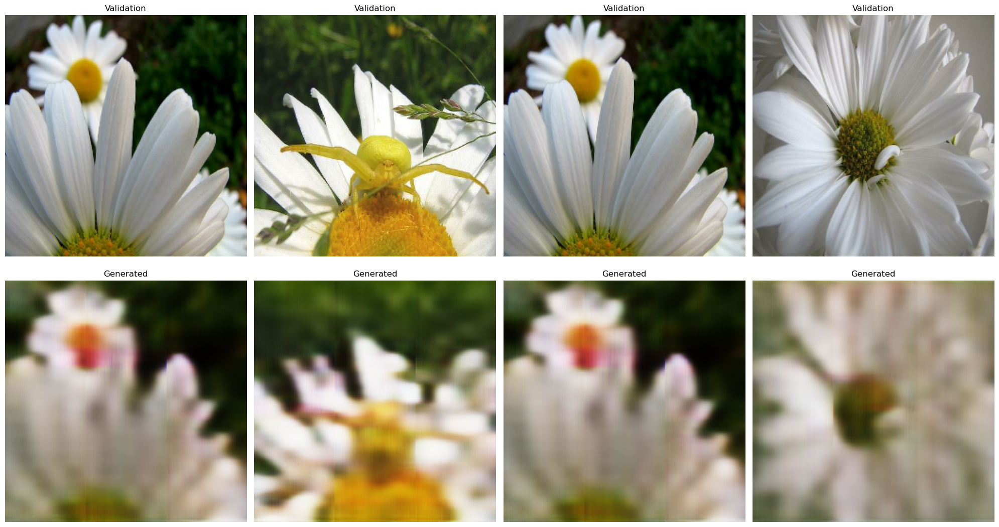

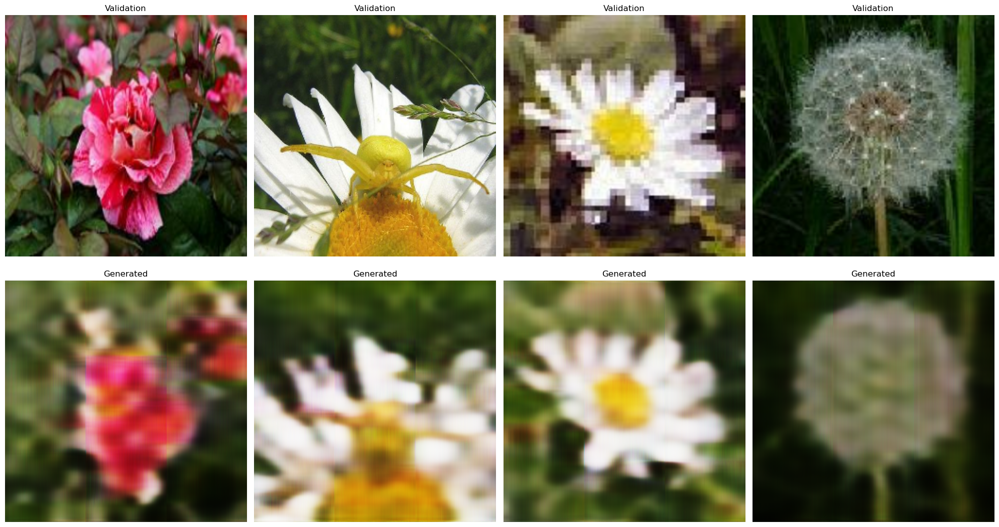

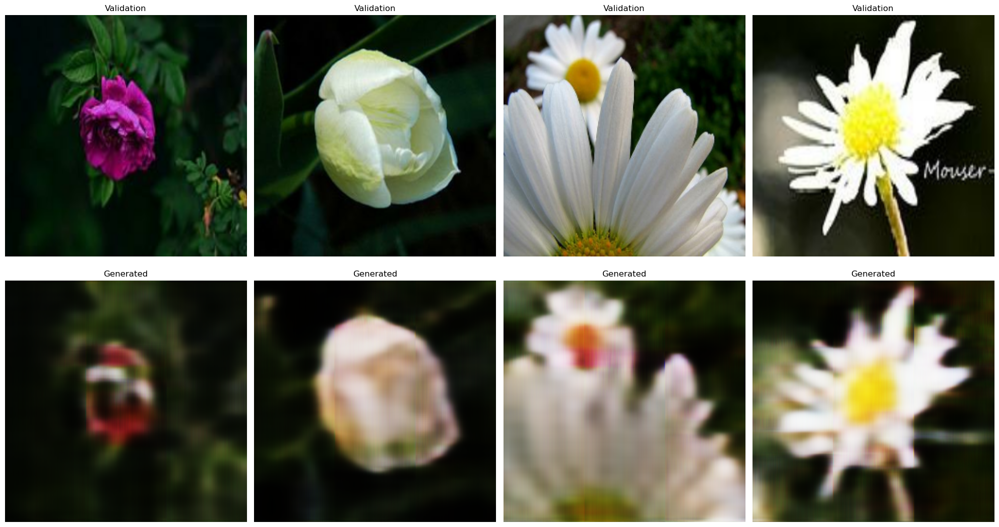

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.


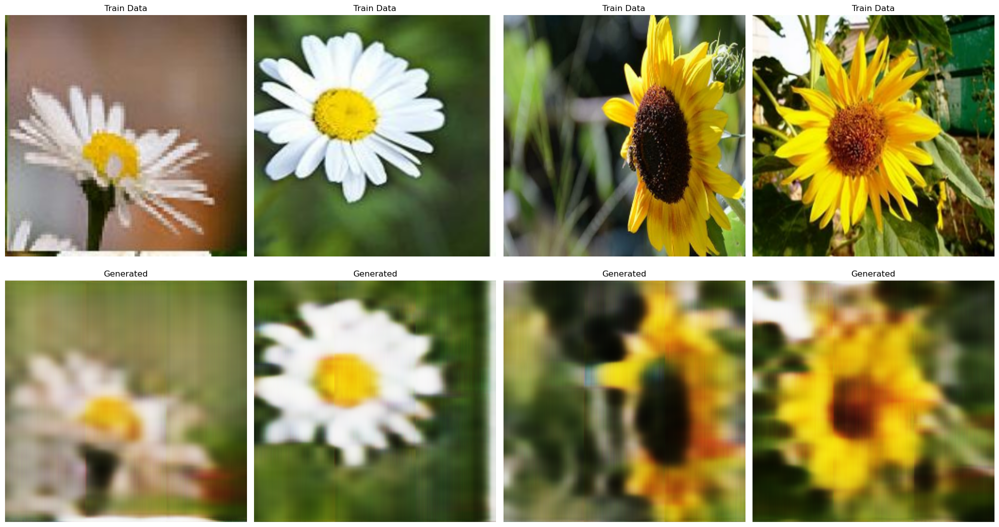

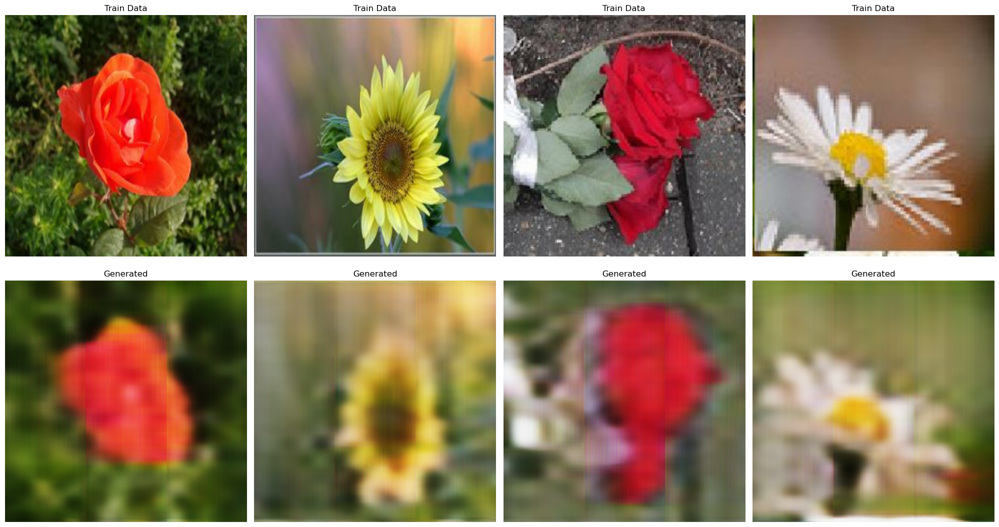

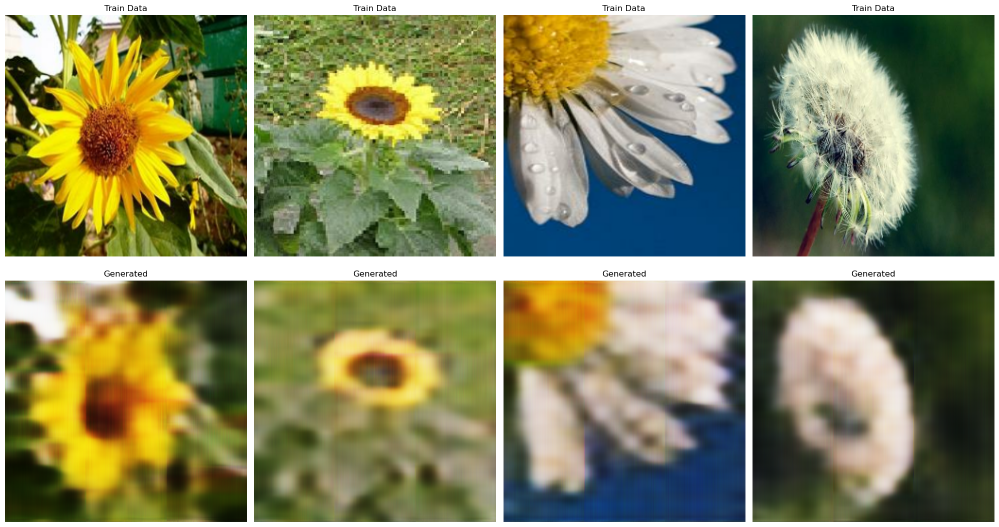

In [8]:
def show_row_images(raw_data, title):
    data = np.array([i[0][0] for count, i in enumerate(raw_data)
                         if count < 32])
    generated_images = vae.predict(data, verbose=False)

    num_images = 4

    plt.figure(figsize=(20, 11))

    for _ in range(num_images):
        random_num = randint(0, 32-1)

        # Оригинальное изображение
        plt.subplot(2, num_images, _ + 1)
        plt.imshow(data[random_num])
        plt.gray()
        plt.title(title)
        plt.axis("off")

        # Сгенерированное изображение
        plt.subplot(2, num_images, _ + num_images + 1)
        plt.imshow(generated_images[random_num])
        plt.gray()
        plt.title("Generated")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

_, val_data = init_data_with_batch_size(1)
for _ in range(3):
    show_row_images(val_data, "Validation")

train_data, _ = init_data_with_batch_size(1)
for _ in range(3):
    show_row_images(train_data, "Train Data")

Found 2799 files belonging to 5 classes.
Using 2520 files for training.
Found 2799 files belonging to 5 classes.
Using 279 files for validation.
2520/2520 [==============================] - 51s 20ms/step
mean all_hidden_data (ideal: 0): 2.9951124
std all_hidden_data (ideal: 1): 5.458669


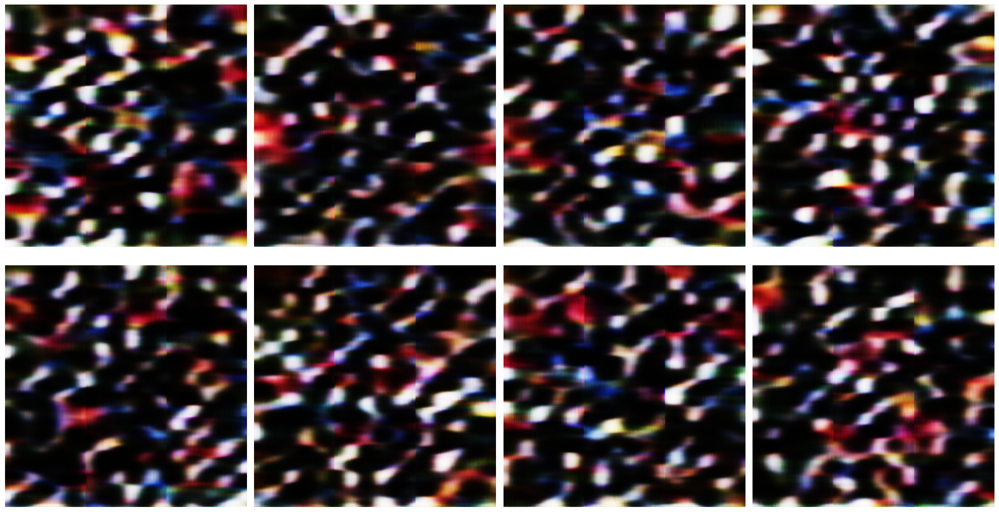

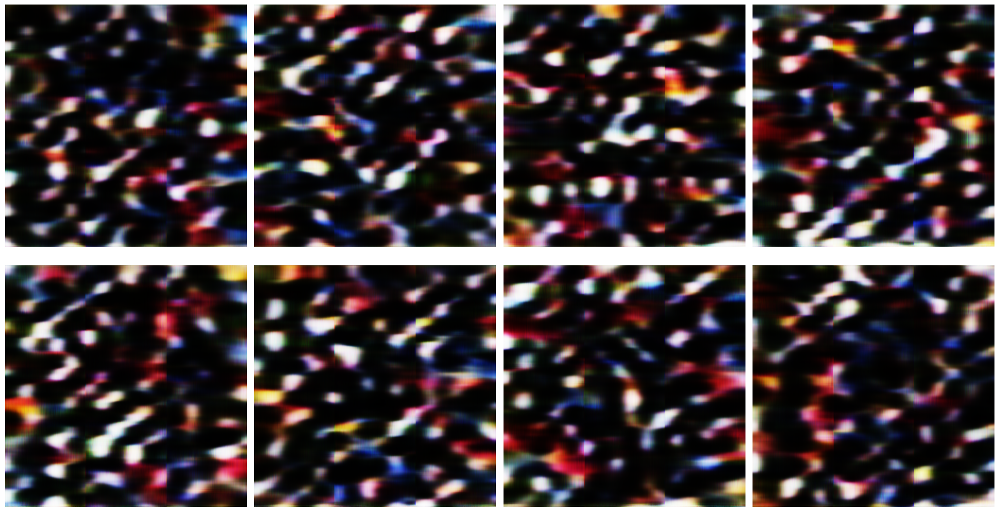

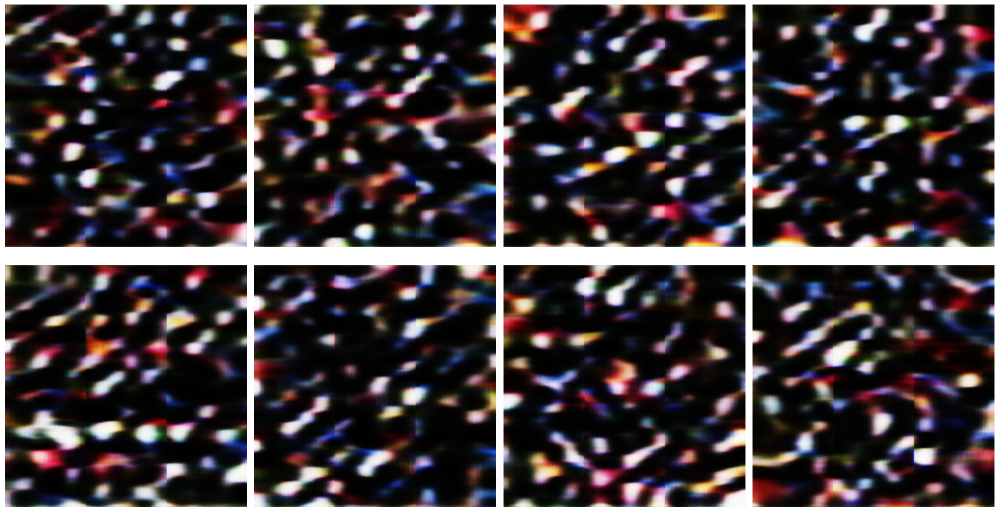

In [9]:
all_hidden_data = encoder.predict(init_data_with_batch_size(1)[0])
mean, std = np.mean(all_hidden_data), np.std(all_hidden_data)
print("mean all_hidden_data (ideal: 0):", mean)
print("std all_hidden_data (ideal: 1):", std)

for _ in range(3):
    num_images = 4

    noise = np.random.normal(mean, std, [num_images*2, *hidden_shape])
    generated_images = np.array(decoder.predict(noise, verbose=False))

    plt.figure(figsize=(20, 11))

    for i in range(num_images):
        # Оригинальное изображение
        plt.subplot(2, num_images, i + 1)

        # Переводим в промежуток [0; 1]
        plt.imshow(generated_images[i + num_images])
        plt.axis("off")

        # Сгенерированное изображение
        plt.subplot(2, num_images, i + num_images + 1)
        plt.imshow(generated_images[i])
        plt.axis("off")
    plt.tight_layout()
    plt.show()

In [10]:
"""Выводим Архитектуру"""
encoder_img = tf.keras.utils.plot_model(encoder, to_file="encoder.png", show_shapes=False, show_layer_names=False,
                                        dpi=128, show_layer_activations=False)

decoder_img = tf.keras.utils.plot_model(decoder, to_file="decoder.png", show_shapes=False, show_layer_names=False,
                                        dpi=128, show_layer_activations=False)